# C. Light: Denoising Dataset

File Information:

Author: Aathreya Kadambi (with some assistance from GPT to more quickly generate code given the time constraints)

Details: Jupyter Notebook for EDA for Denoising Task during Berkeley Datathon

## Imports

In [5]:
# general
import os
from datetime import datetime

# data science imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# image analysis
import cv2

import torch
from torch import nn
import torch.optim as optim
from torch.utils.data import DataLoader, Subset, random_split
from torchvision import datasets, transforms
import torchvision.utils as vutils
from torchvision.utils import make_grid

## Global Tables, Variables, and Symbols

In [6]:
dataset_link = '../../res/raw_data/denoising/Denoising/'

In [7]:
def display_image_str(path : str):
    img = cv2.imread(path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    plt.show()

def display_image_cv2(img : cv2.typing.MatLike):
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_rgb)
    plt.show()

def display_images(images):
    fig, axes = plt.subplots(nrows=1, ncols=len(images), figsize=(15, 3))
    for ax, image in zip(axes, images):
        ax.imshow(image.squeeze().permute(1, 2, 0).cpu().numpy())
        ax.axis('off')
    plt.show()

In [8]:
directory = 'path_to_your_directory'

image_links = {
    'good' : [os.path.join(dataset_link + 'good/', file) for file in os.listdir(dataset_link + 'good/') 
              if os.path.isfile(os.path.join(dataset_link + 'good/', file))],
    'bad' : [os.path.join(dataset_link + 'bad/', file) for file in os.listdir(dataset_link + 'bad/') 
              if os.path.isfile(os.path.join(dataset_link + 'bad/', file))]
}

In [9]:
print('number of good links: ' + str(len(image_links['good'])))
print('number of bad links: ' + str(len(image_links['bad'])))

number of good links: 147
number of bad links: 515


In [10]:
image = cv2.imread(image_links['bad'][0])
image.shape

(480, 640, 3)

In [11]:
transform = transforms.Compose([
    transforms.Resize((240, 320)),  # Resize to 240x320
    transforms.CenterCrop(224),     # Crop the image to 224x224 <- slightly sketchy gpt code, I kind of disagree with this step but we'll see, maybe I can use it later
    transforms.ToTensor(),          # Convert the image to a PyTorch tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),  # Normalize
])


In [12]:
torch_dataset = datasets.ImageFolder(root=dataset_link, transform=transform)
torch_dataset

Dataset ImageFolder
    Number of datapoints: 662
    Root location: ../../res/raw_data/denoising/Denoising/
    StandardTransform
Transform: Compose(
               Resize(size=(240, 320), interpolation=bilinear, max_size=None, antialias=warn)
               CenterCrop(size=(224, 224))
               ToTensor()
               Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
           )

In [13]:
total_size = len(torch_dataset)
train_size = int(0.7 * total_size)
val_size = int(0.1 * total_size)
test_size = total_size - train_size - val_size

In [14]:
train_dataset, val_dataset, test_dataset = random_split(torch_dataset, [train_size, val_size, test_size])

In [15]:
good_indices = [i for i, (_, label) in enumerate(train_dataset) if label == 1]
bad_indices = [i for i, (_, label) in enumerate(train_dataset) if label == 0]
train_dataset_good = Subset(train_dataset, good_indices)
train_dataset_bad = Subset(train_dataset, bad_indices)

good_indices = [i for i, (_, label) in enumerate(val_dataset) if label == 1]
bad_indices = [i for i, (_, label) in enumerate(val_dataset) if label == 0]
val_dataset_good = Subset(val_dataset, good_indices)
val_dataset_bad = Subset(val_dataset, bad_indices)

good_indices = [i for i, (_, label) in enumerate(test_dataset) if label == 1]
bad_indices = [i for i, (_, label) in enumerate(test_dataset) if label == 0]
test_dataset_good = Subset(test_dataset, good_indices)
test_datasett_bad = Subset(test_dataset, bad_indices)

### VAEs

In [336]:
class VAE(nn.Module):
    def __init__(self):
        super(VAE, self).__init__()
        
        # Define the number of input features for 224x224 RGB images
        self.num_input_features = 224 * 224 * 3  # For RGB images
        self.num_latent_features = 10
        
        # Encoder
        self.encoder = nn.Sequential(
            nn.Linear(self.num_input_features, 400),
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(400, self.num_latent_features)
        self.fc_log_var = nn.Linear(400, self.num_latent_features)
        
        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(self.num_latent_features, 400),
            nn.ReLU(),
            nn.Linear(400, self.num_input_features),
            nn.Sigmoid(),
        )

    def reparameterize(self, mu, log_var):
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        # Flatten the image
        x = x.view(-1, self.num_input_features)
        # Encoder
        mu, log_var = self.fc_mu(self.encoder(x)), self.fc_log_var(self.encoder(x))
        # Reparameterization trick
        z = self.reparameterize(mu, log_var)
        # Decoder
        reconstructed_x = self.decoder(z)
        # Reshape the output to match the input shape (batch_size, channels, height, width)
        reconstructed_x = reconstructed_x.view(-1, 3, 224, 224)  # Reshape for RGB images
        return reconstructed_x, mu, log_var

In [337]:
# Binary cross entropy
# not the best, makes things a bit blurrier and also make things focused a lot around the center, as we see below
def vae_loss_bce(reconstructed_x, original_x, mu, log_var):
    # Calculate the binary cross-entropy loss for reconstruction
    recon_loss = nn.functional.binary_cross_entropy_with_logits(reconstructed_x, original_x, reduction='sum')
    
    # KL divergence between the distribution of encoded representations and the prior (standard normal distribution)
    kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
    
    # The total loss is the sum of the reconstruction loss and the KL divergence
    total_loss = recon_loss + kl_div
    
    # We return the total loss as well as the individual components for detailed inspection
    return total_loss, recon_loss, kl_div

In [338]:
def vae_loss_bce_2(reconstructed_x, original_x, mu, log_var):
    # Reconstruction loss (assuming the input is normalized between 0 and 1)
    # Since the input is multi-channel, ensure you apply the loss across all channels
    recon_loss = nn.functional.binary_cross_entropy(reconstructed_x.view(-1, 3 * 224 * 224), original_x.view(-1, 3 * 224 * 224), reduction='sum')
    
    # KL divergence
    kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
    
    # Total loss
    total_loss = recon_loss + kl_div
    return total_loss


In [339]:
def vae_loss_mse(reconstructed_x, original_x, mu, log_var):
    # MSE reconstruction loss
    recon_loss = nn.functional.mse_loss(reconstructed_x.view(-1, 3 * 224 * 224), original_x.view(-1, 3 * 224 * 224), reduction='sum')
    
    # KL divergence between the distribution of encoded representations and the prior (standard normal distribution)
    kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
    
    # Total loss is the sum of the reconstruction loss and the KL divergence
    total_loss = recon_loss + kl_div
    
    return total_loss, recon_loss, kl_div

In [340]:
def vae_loss_mse_2(reconstructed_x, original_x, mu, log_var):
    # MSE reconstruction loss
    recon_loss = nn.functional.mse_loss(reconstructed_x.view(-1, 3 * 224 * 224), original_x.view(-1, 3 * 224 * 224), reduction='sum')
    
    # KL divergence between the distribution of encoded representations and the prior (standard normal distribution)
    kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
    
    # Total loss is the sum of the reconstruction loss and the KL divergence
    total_loss = recon_loss + kl_div
    
    return total_loss

In [341]:
def evaluate_vae(model, data_loader, criterion):
    model.eval()  # Set the model to evaluation mode
    total_loss = 0.0
    total_recon_loss = 0.0
    total_kl_divergence = 0.0

    with torch.no_grad():  # No need to track the gradients
        for batch_idx, (data, _) in enumerate(data_loader):
            # Forward pass through the model to get the reconstructions and latent variables
            recon_data, mu, log_var = model(data)

            # Compute the loss
            loss, recon_loss, kl_divergence = criterion(recon_data, data, mu, log_var)

            # Update the total loss and the total KL divergence
            total_loss += loss.item()
            total_recon_loss += recon_loss.item()
            total_kl_divergence += kl_divergence.item()

    # Compute the average loss and KL divergence over the entire dataset
    avg_loss = total_loss / len(data_loader.dataset)
    avg_recon_loss = total_recon_loss / len(data_loader.dataset)
    avg_kl_divergence = total_kl_divergence / len(data_loader.dataset)

    return avg_loss, avg_recon_loss, avg_kl_divergence

In [342]:
def generate_samples(vae_model, num_samples):
    vae_model.eval()  # Put the model in evaluation mode

    with torch.no_grad():  # No need to track gradients for generation
        # Sample from the standard normal distribution
        z = torch.randn(num_samples, vae_model.num_latent_features)
        
        # If you have a GPU, move the latent variables there
        z = z.to(next(vae_model.parameters()).device)
        
        # Pass the latent variables through the decoder to get the samples
        generated_samples = vae_model.decoder(z)
        
        # You might need to reshape the samples depending on your VAE's output
        generated_samples = generated_samples.view(num_samples, 3, 224, 224)  # Adjust the shape as needed
        
    return generated_samples

### CVAEs

In [343]:
class CVAE(nn.Module):
    def __init__(self, num_input_features, num_latent_features):
        super(CVAE, self).__init__()
        
        self.num_input_features = num_input_features
        self.num_latent_features = num_latent_features
        
        # Encoder
        self.fc1 = nn.Linear(self.num_input_features + 1, 400)
        self.fc_mu = nn.Linear(400, self.num_latent_features)
        self.fc_log_var = nn.Linear(400, self.num_latent_features)
        
        # Decoder
        self.fc2 = nn.Linear(self.num_latent_features + 1, 400)
        self.fc3 = nn.Linear(400, self.num_input_features)
        
    def reparameterize(self, mu, log_var):
        std = torch.exp(0.5 * log_var)
        eps = torch.randn_like(std)
        return mu + eps * std
        
    def encode(self, x, labels):
        # Concatenate input features and labels
        combined = torch.cat([x, labels.unsqueeze(-1)], dim=1)  # Make sure labels are the right shape
        h = F.relu(self.fc1(combined))
        return self.fc_mu(h), self.fc_log_var(h)
        
    def decode(self, z, labels):
        # Concatenate latent z and labels
        combined = torch.cat([z, labels.unsqueeze(-1)], dim=1)  # Make sure labels are the right shape
        h = nn.functional.relu(self.fc2(combined))
        return torch.sigmoid(self.fc3(h))

    def forward(self, x):
        # x should be flattened input features
        mu, log_var = self.encode(x, [0, 1])
        z = self.reparameterize(mu, log_var)
        reconstructed_x = self.decode(z, [0, 1])
        return reconstructed_x, mu, log_var

In [329]:
def cvae_loss(reconstructed_x, original_x, mu, log_var, labels, recon_loss_factor=1.0):
    # This factor can be used to weight the reconstruction loss differently for different classes if needed
    # For now, it's set to 1.0, meaning no difference in weighting
    
    # Reconstruction loss using Binary Cross Entropy
    # Flatten the output and input to compare pixel-wise
    recon_loss = nn.functional.binary_cross_entropy_with_logits(reconstructed_x.view(-1, 3 * 224 * 224), 
                                                    original_x.view(-1, 3 * 224 * 224), reduction='sum')
    
    # You can use the labels to condition the reconstruction loss if necessary
    # For example, if you want to weight the reconstruction loss differently for different classes:
    recon_loss *= recon_loss_factor
    
    # KL divergence (regularization term)
    kl_div = -0.5 * torch.sum(1 + log_var - mu.pow(2) - log_var.exp())
    
    # Total loss is the sum of the reconstruction loss and the KL divergence
    total_loss = recon_loss + kl_div
    
    return total_loss, recon_loss, kl_div

## EDA

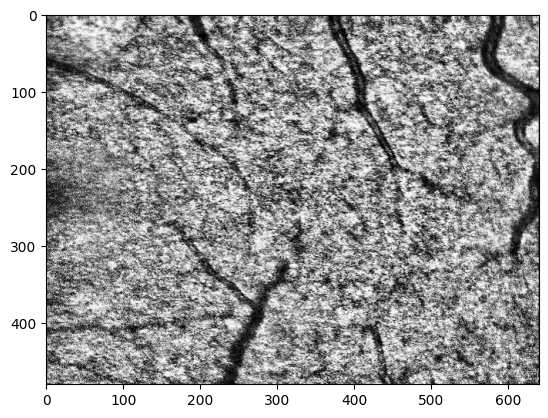

In [211]:
display_image_str(image_links['bad'][0])

### CNNs

### Autoencoders

#### VAEs

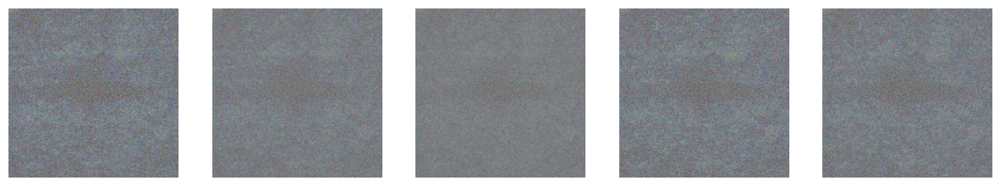

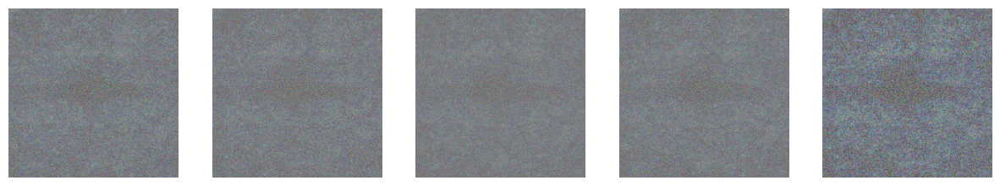

Epoch 1, Loss: 231676.58333333334


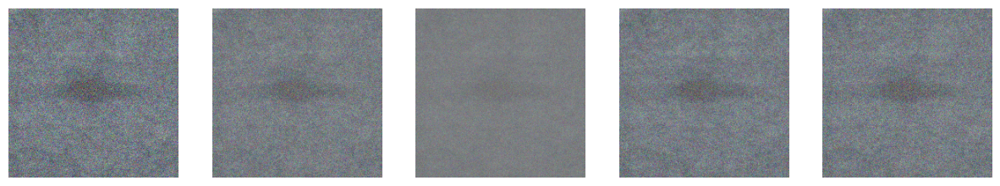

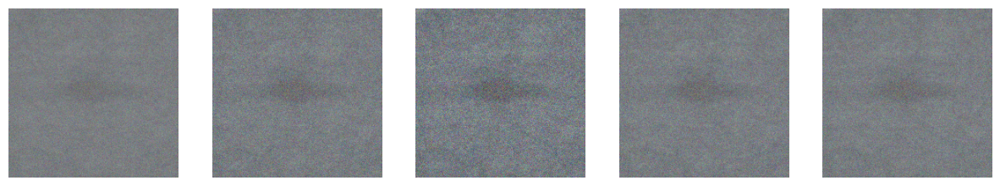

Epoch 2, Loss: 331249.7450980392


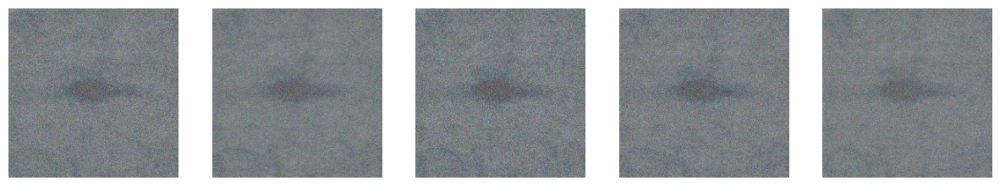

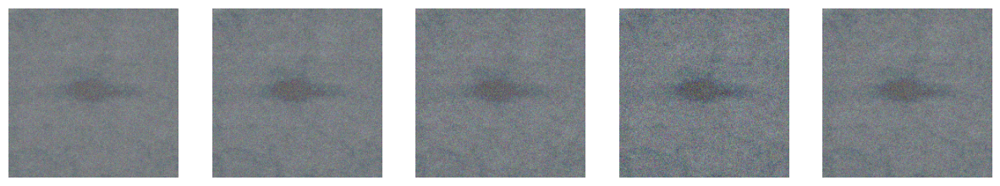

Epoch 3, Loss: 179747.98529411765


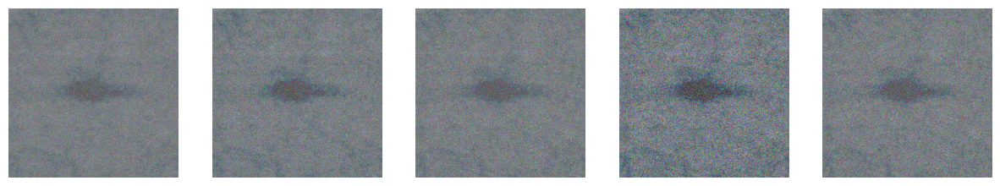

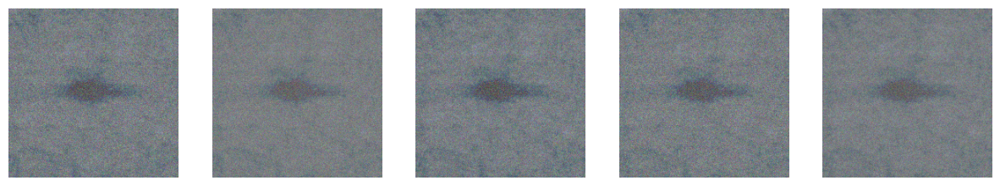

Epoch 4, Loss: 157527.79901960783


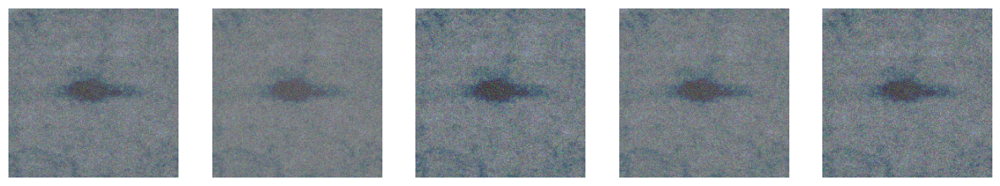

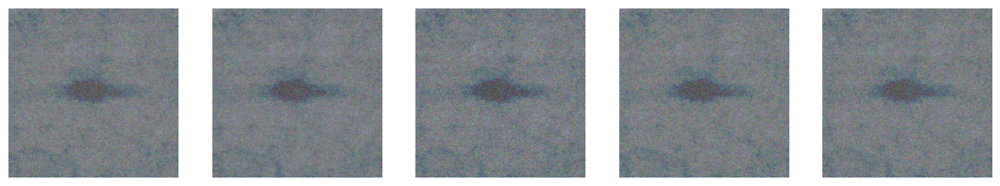

Epoch 5, Loss: 133261.9975490196


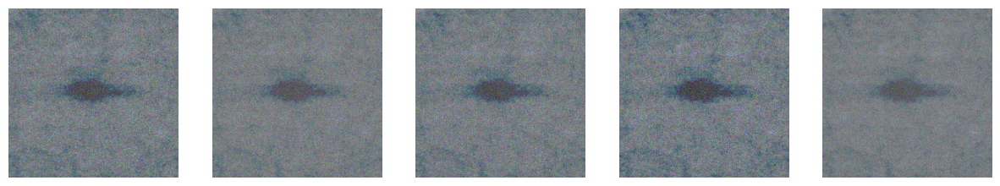

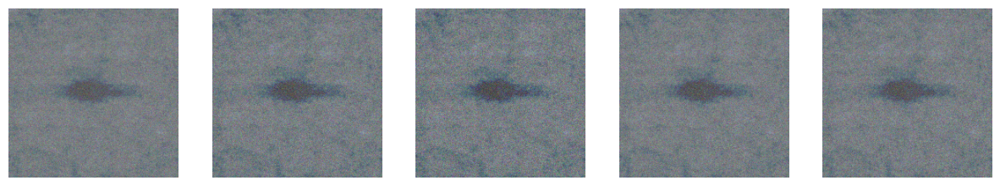

Epoch 6, Loss: 111409.9093137255


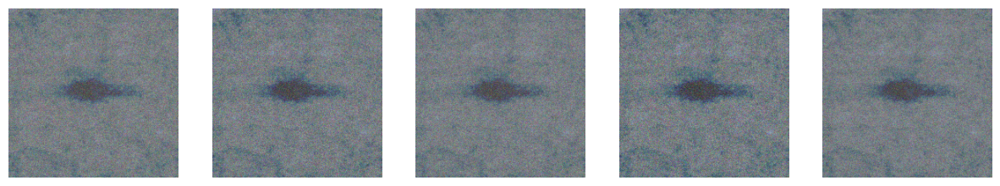

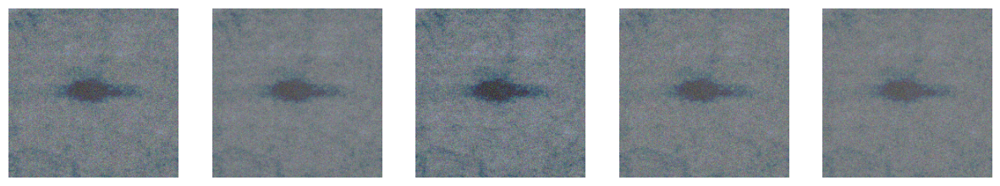

Epoch 7, Loss: 103186.91176470589


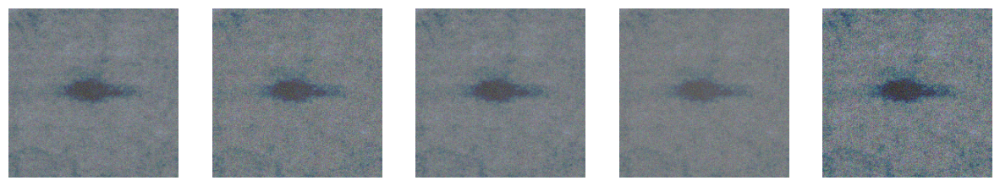

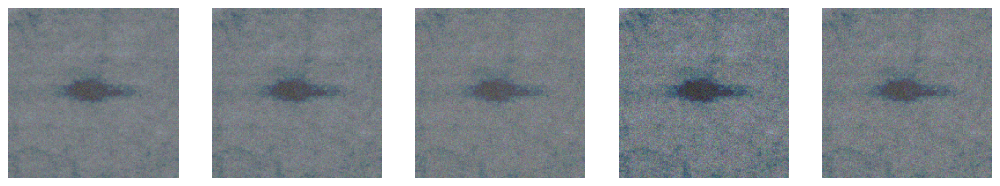

Epoch 8, Loss: 94738.70343137255


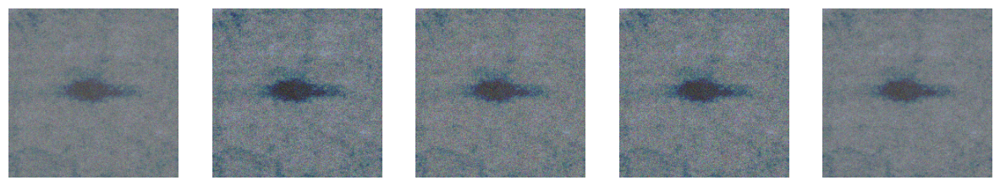

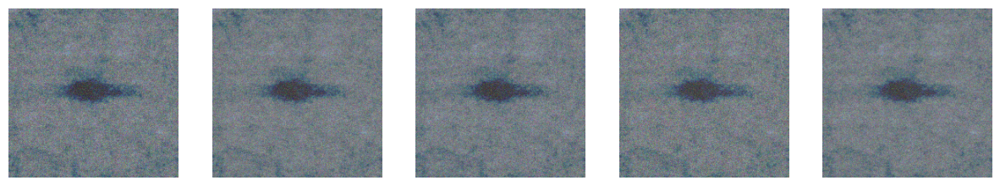

Epoch 9, Loss: 89832.60539215687


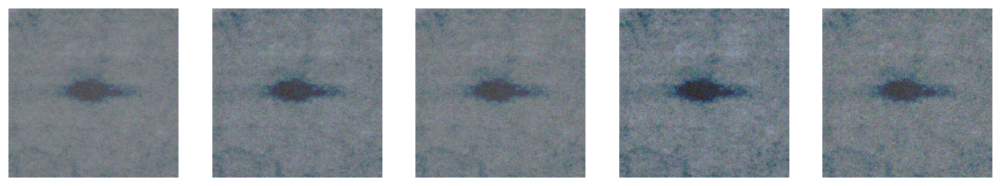

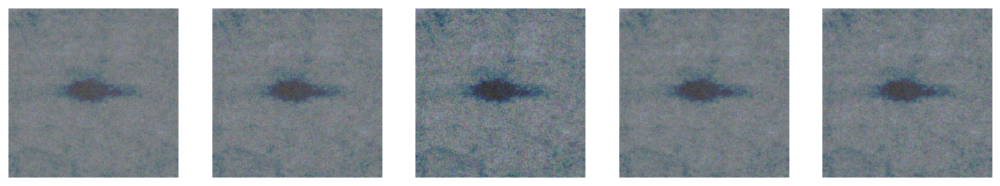

Epoch 10, Loss: 87136.2818627451


In [344]:
# Hyperparameters
batch_size = 64
learning_rate = 1e-3

# Data transforms
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# Data loaders
train_loader = DataLoader(train_dataset_good, batch_size=batch_size, shuffle=True)

# Model, optimizer, and criterion
vae_model = VAE()
optimizer = torch.optim.Adam(vae_model.parameters(), lr=learning_rate)

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    vae_model.train()
    train_loss = 0
    for batch_idx, (data, _) in enumerate(train_loader):
        optimizer.zero_grad()
        reconstructed_batch, mu, log_var = vae_model(data)
        loss = vae_loss_bce_2(reconstructed_batch, data, mu, log_var)
        loss.backward()
        train_loss += loss.item()
        optimizer.step()
        
    if True:
        new_samples = generate_samples(vae_model, 10)
        display_images(new_samples[:5])
        display_images(new_samples[5:])
    print(f'Epoch {epoch+1}, Loss: {train_loss/len(train_loader.dataset)}')


In [292]:
torch.save(vae_model.state_dict(), 'vae_model_1_64_1e-3_10_' + str(datetime.now().strftime("%H:%M:%S")) + '.pth') # vae_model_i_batch size_learning rate_num epochs.pth

In [293]:
test_loader = DataLoader(test_dataset_good, batch_size=batch_size, shuffle=True)

In [294]:
print('Model Stats: ')
avg_loss, avg_recon_loss, avg_kl_divergence = evaluate_vae(vae_model, test_loader, vae_loss_bce)
print(f"Average Loss: {avg_loss}")
print(f"Average Reconstruction Loss: {avg_recon_loss}")
print(f"Average KL Divergence: {avg_kl_divergence}")

Model Stats: 


Average Loss: 114677.37931034483
Average Reconstruction Loss: 112731.89655172414
Average KL Divergence: 1945.4820851293102


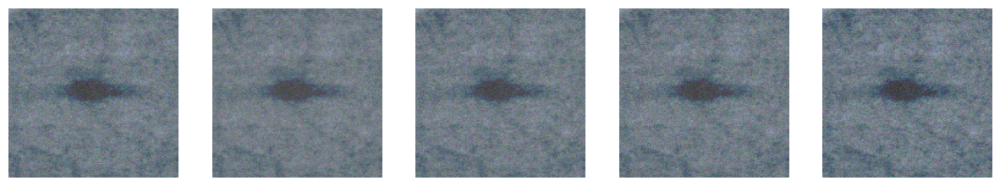

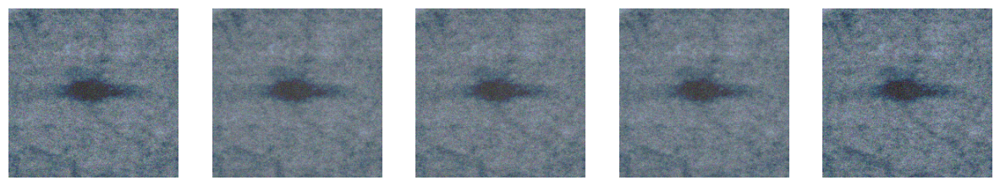

In [249]:
new_samples = generate_samples(vae_model, 10)
display_images(new_samples[:5])
display_images(new_samples[5:])

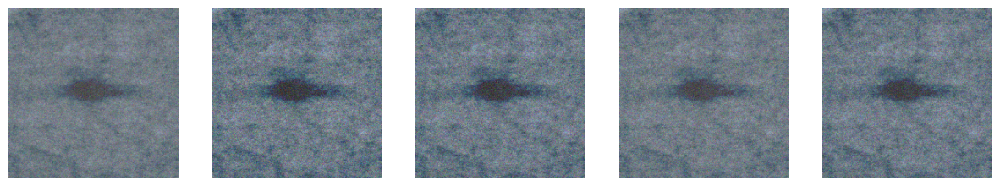

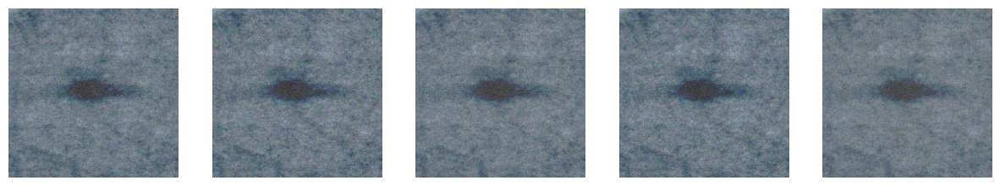

Epoch 1, Loss: 125706.01960784313


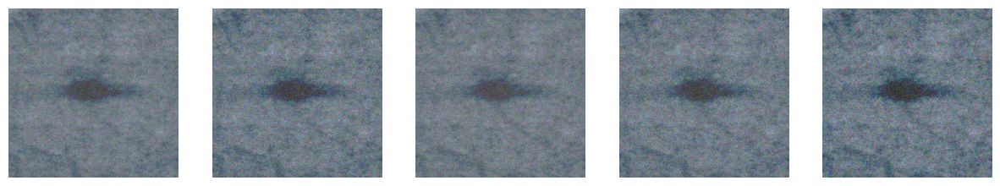

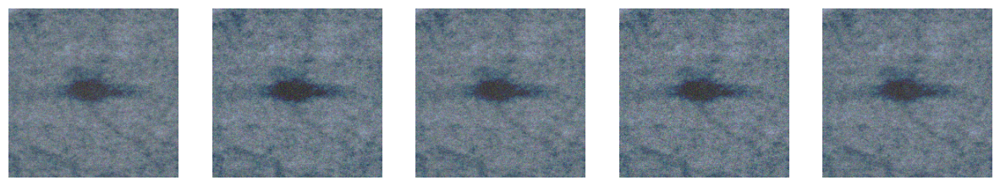

Epoch 2, Loss: 134160.98039215687


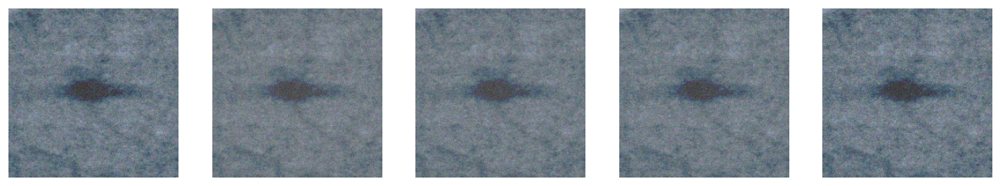

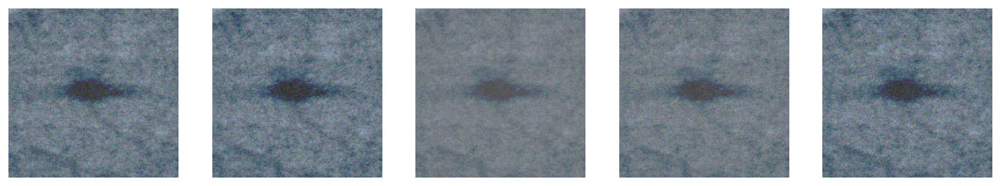

Epoch 3, Loss: 127890.36274509804


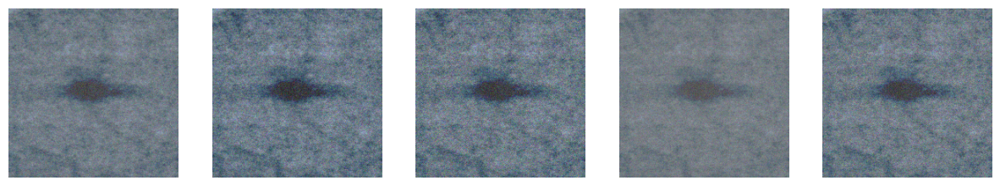

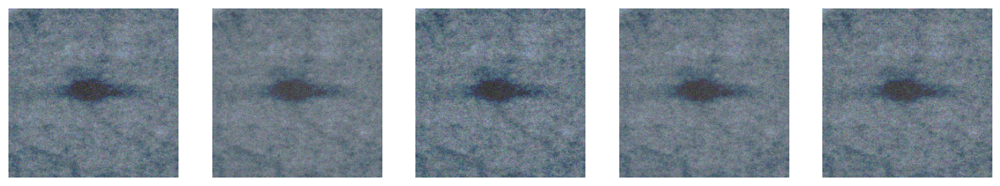

Epoch 4, Loss: 34653570586.64706


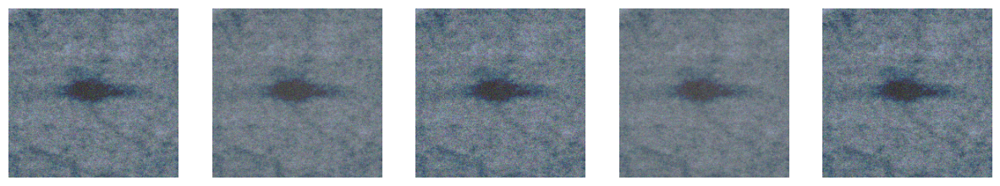

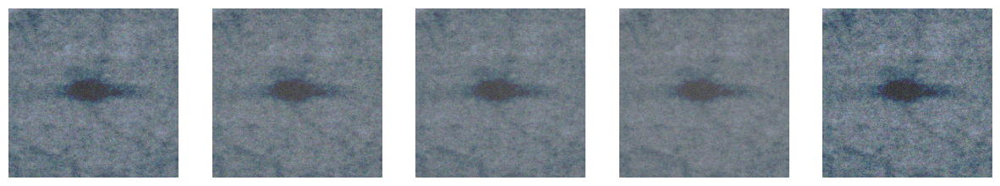

Epoch 5, Loss: 1.5362396470086275e+19


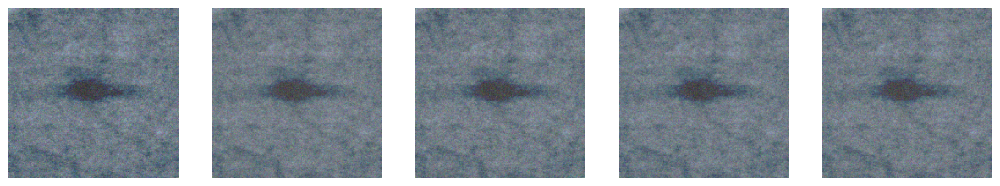

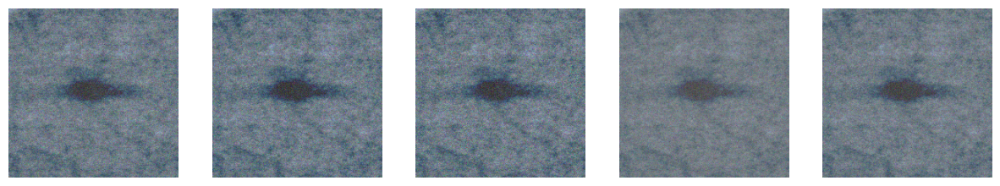

Epoch 6, Loss: 3.4790423540375864e+16


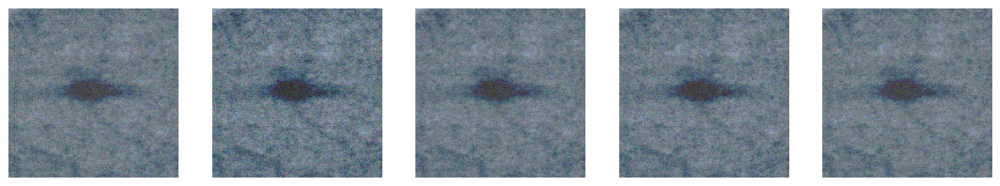

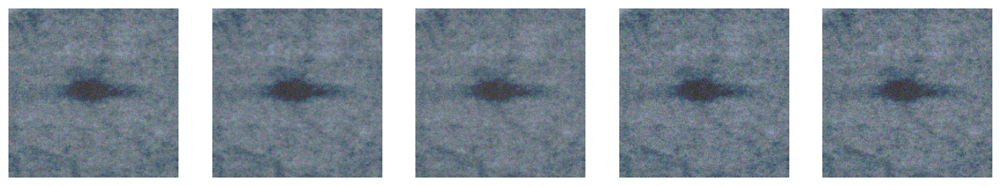

Epoch 7, Loss: 1.0725480686066219e+23


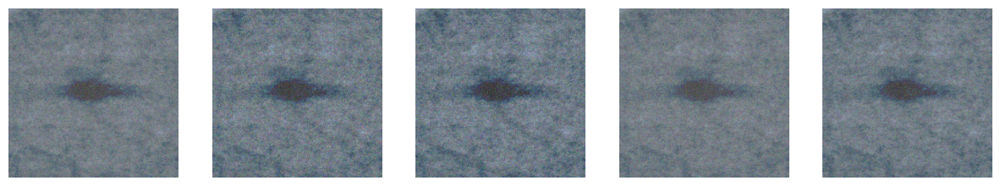

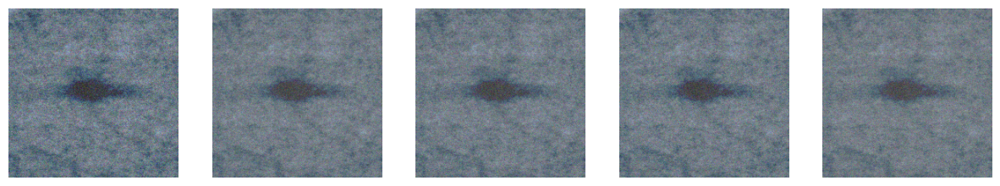

Epoch 8, Loss: 1.2146052917967545e+23


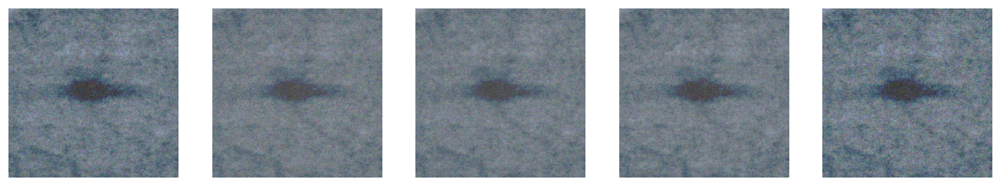

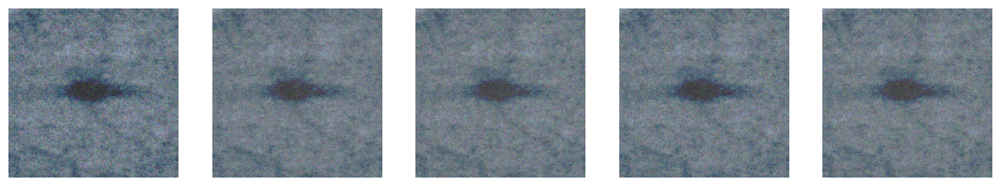

Epoch 9, Loss: 1.2142949072426713e+23


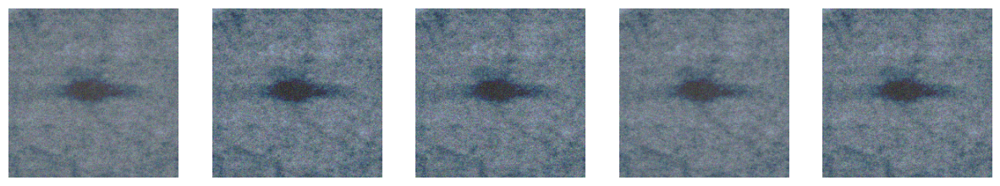

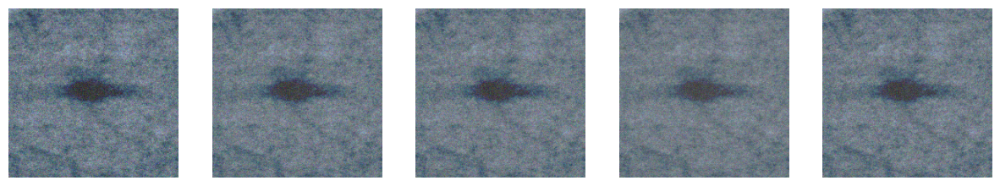

Epoch 10, Loss: 8.201988137929165e+22


In [251]:
# Model, optimizer, and criterion
vae_model_2 = VAE()
optimizer = torch.optim.Adam(vae_model_2.parameters(), lr=learning_rate)

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    vae_model_2.train()
    train_loss = 0
    for batch_idx, (data, _) in enumerate(train_loader):
        optimizer.zero_grad()
        reconstructed_batch, mu, log_var = vae_model_2(data)
        loss = vae_loss_mse_2(reconstructed_batch, data, mu, log_var)
        loss.backward()
        train_loss += loss.item()
        optimizer.step()

    if True:
        new_samples = generate_samples(vae_model, 10)
        display_images(new_samples[:5])
        display_images(new_samples[5:])
    print(f'Epoch {epoch+1}, Loss: {train_loss/len(train_loader.dataset)}')

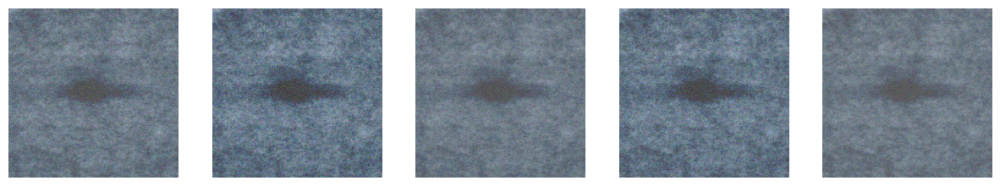

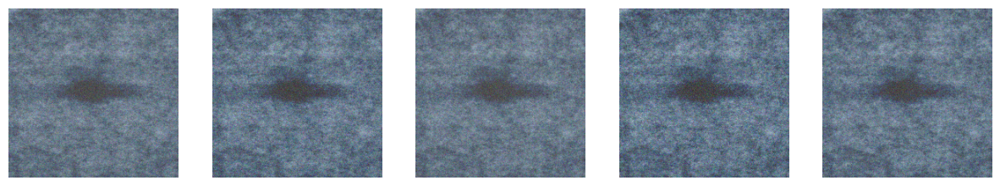

In [253]:
new_samples = generate_samples(vae_model_2, 10)
display_images(new_samples[:5])
display_images(new_samples[5:])

In [254]:
device = torch.device('cpu') #torch.device('mps')
for epoch in range(num_epochs):
    for data in train_loader:
        optimizer.zero_grad()
        images = data[0].to(device)
        reconstructed_images, mu, log_var = vae_model(images)
        loss, mse, kl_div = vae_loss_mse(reconstructed_images, images, mu, log_var)
        loss.backward()
        optimizer.step()


#### CVAEs

In [263]:
# Hyperparameters
batch_size = 64
learning_rate = 1e-3

# Data transforms
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

# Data loaders
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

# Model, optimizer, and criterion
num_input_features = 224 * 224 * 3  # For RGB images of size 224x224
num_latent_features = 20
vae_model = CVAE(num_input_features=num_latent_features, num_latent_features=num_latent_features)
optimizer = torch.optim.Adam(vae_model.parameters(), lr=learning_rate)

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    vae_model.train()
    train_loss = 0
    for batch_idx, (data, labels) in enumerate(train_loader):
        data = data.to(device)
        labels = labels.to(device).float().unsqueeze(-1)
        
        optimizer.zero_grad()
        
        reconstructed_batch, mu, log_var = vae_model(data, labels)
        loss, _, _ = cvae_loss(reconstructed_batch, data, mu, log_var, labels)
        
        loss.backward()
        train_loss += loss.item()
        optimizer.step()
    
    print(f'Epoch {epoch+1}, Loss: {train_loss/len(train_loader.dataset)}')



TypeError: CVAE.forward() takes 2 positional arguments but 3 were given

#### Denoising Autoencoder

### Siamese Networks

### Transformers

### Triplet Networks

### Feature Extraction

#### RGB Breakdown

In [16]:
image = cv2.imread(image_links['good'][0])
histograms = {}
colors = ['b', 'g', 'r']

for i, col in enumerate(colors):
    histograms[col] = cv2.calcHist([image], [i], None, [256], [0, 256])

In [17]:
max_height = max([hist.max() for hist in histograms.values()])

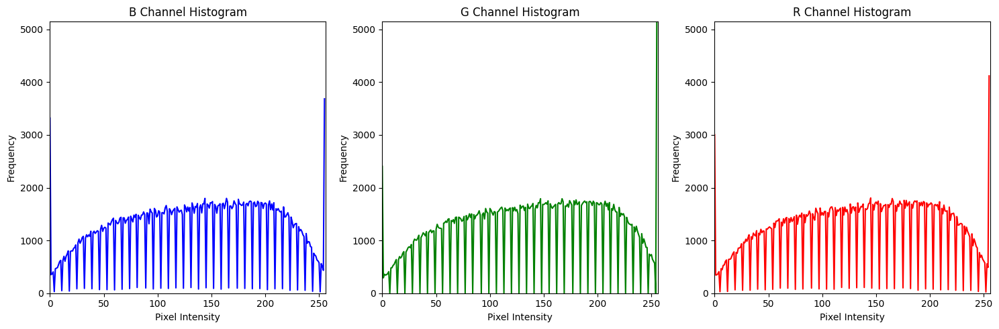

In [18]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))

for i, col in enumerate(colors):
    ax = axes[i]
    ax.plot(histograms[col], color=col)
    ax.set_xlim([0, 256])
    ax.set_ylim([0, max_height])  # Set the same y-axis limit for each subplot
    ax.set_title(f'{col.upper()} Channel Histogram')
    ax.set_xlabel('Pixel Intensity')
    ax.set_ylabel('Frequency')

plt.tight_layout()
plt.show()


#### ORB

In [19]:
image = cv2.imread(image_links['bad'][0])
orb = cv2.ORB_create()
keypoints, descriptors = orb.detectAndCompute(image, None)

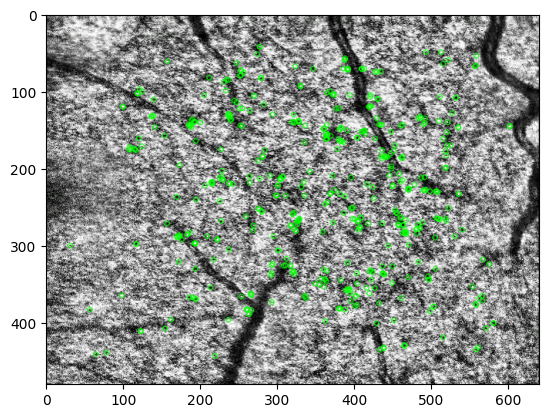

In [20]:
# Draw keypoints on the image
keypoint_image = cv2.drawKeypoints(image, keypoints, None, color=(0, 255, 0), flags=0)

# Display the image with keypoints
display_image_cv2(keypoint_image)

#### Averaging

In [21]:
avg_image = {}

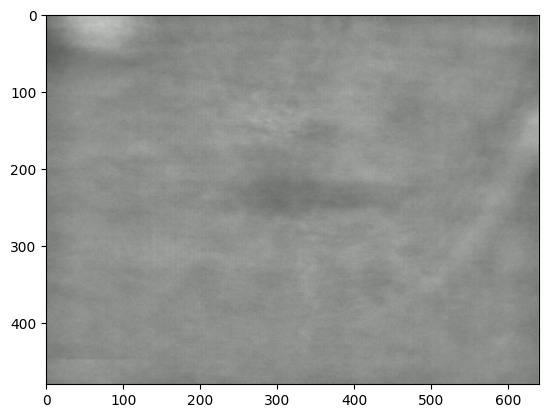

In [22]:
# Load the first image to get the shape
first_image = cv2.imread(image_links['bad'][0])
avg_image['bad'] = np.zeros_like(first_image, np.float32)

# Sum all images
for path in image_links['bad']:
    img = cv2.imread(path)
    avg_image['bad'] += img.astype(np.float32)

# Average the sum
avg_image['bad'] /= len(image_links['bad'])

# Convert back to uint8
avg_image['bad'] = np.clip(avg_image['bad'], 0, 255).astype(np.uint8)

# Save or display the averaged image
display_image_cv2(avg_image['bad'])

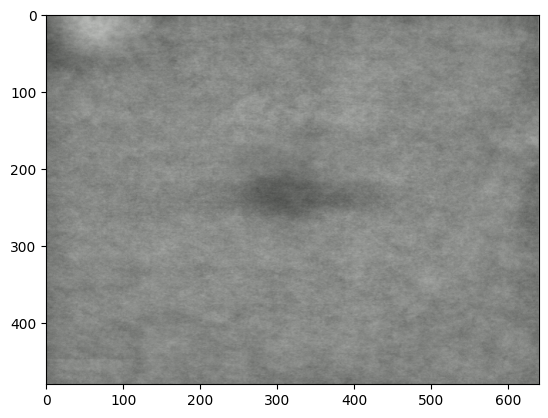

In [23]:
# Load the first image to get the shape
first_image = cv2.imread(image_links['good'][0])
avg_image['good'] = np.zeros_like(first_image, np.float32)

# Sum all images
for path in image_links['good']:
    img = cv2.imread(path)
    avg_image['good'] += img.astype(np.float32)

# Average the sum
avg_image['good'] /= len(image_links['good'])

# Convert back to uint8
avg_image['good'] = np.clip(avg_image['good'], 0, 255).astype(np.uint8)

# Save or display the averaged image
display_image_cv2(avg_image['good'])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


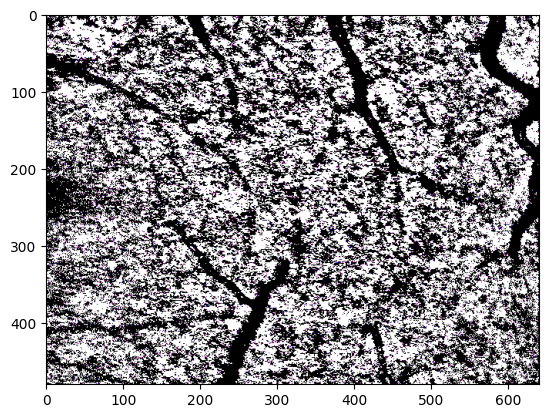

In [24]:
is_good = 'bad'
image = cv2.imread(image_links[is_good][0])
temp = np.zeros_like(first_image, np.float32)
temp += image.astype(np.float32)
temp -= avg_image[is_good].astype(np.float32)

for i in range(len(temp)):
    for j in range(len(temp[0])):
        for k in range(0, 3):
            temp[i][j][k] += 0 # (255 / 2)
display_image_cv2(temp)

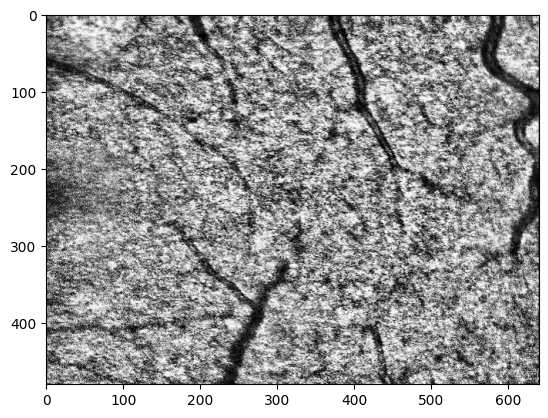

In [25]:
display_image_cv2(image)

In [26]:
image_links['good'][0]

'../../res/raw_data/denoising/Denoising/good/0_822_64b55ec2-c47c-4d95-a61e-53694ed92ed3_mode_1_odos_1_scan_0_raw_mp4_110.png'

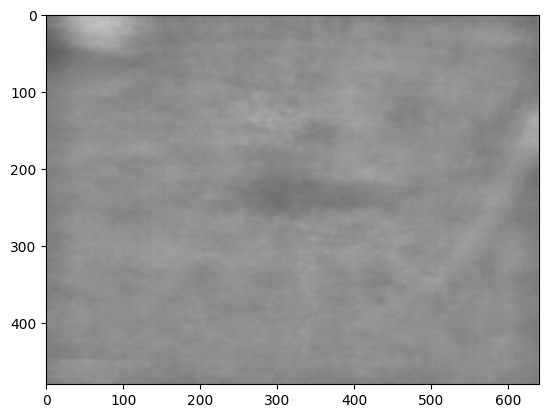

In [27]:
# Load the first image to get the shape
first_image = cv2.imread(image_links['bad'][0])
avg_image['bad'] = np.zeros_like(first_image, np.float32)

# Sum all images
for path in image_links['bad']:
    img = cv2.GaussianBlur(cv2.imread(path), (5, 5), 0)
    avg_image['bad'] += img.astype(np.float32)

# Average the sum
avg_image['bad'] /= len(image_links['bad'])

# Convert back to uint8
avg_image['bad'] = np.clip(avg_image['bad'], 0, 255).astype(np.uint8)

# Save or display the averaged image
display_image_cv2(avg_image['bad'])

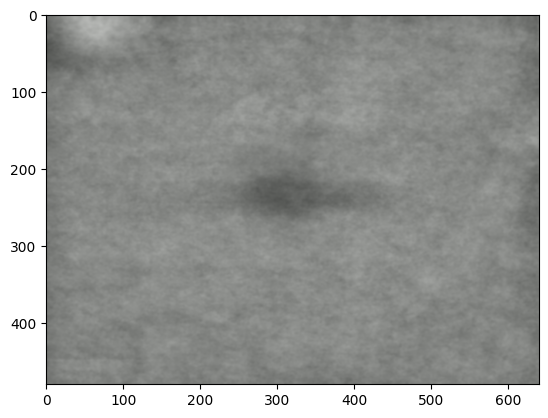

In [28]:
# Load the first image to get the shape
first_image = cv2.imread(image_links['good'][0])
avg_image['good'] = np.zeros_like(first_image, np.float32)

# Sum all images
for path in image_links['good']:
    img = cv2.GaussianBlur(cv2.imread(path), (5, 5), 0)
    avg_image['good'] += img.astype(np.float32)

# Average the sum
avg_image['good'] /= len(image_links['good'])

# Convert back to uint8
avg_image['good'] = np.clip(avg_image['good'], 0, 255).astype(np.uint8)

# Save or display the averaged image
display_image_cv2(avg_image['good'])

#### Contour Detection

In [29]:
image = cv2.imread(image_links['good'][1])
blurred = cv2.GaussianBlur(image, (13, 13), 0)

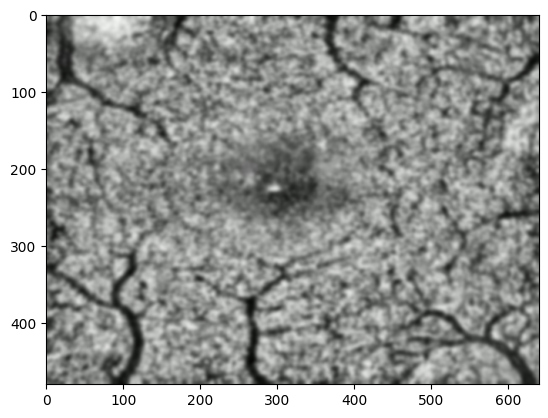

In [30]:
display_image_cv2(blurred)

In [31]:
def plot_edges_and_contours(image):
    blurred = cv2.GaussianBlur(image, (13, 13), 0)
    # Edge detection using Canny
    edges = cv2.Canny(blurred, 100, 200)

    # Find contours
    contours, _ = cv2.findContours(edges, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)

    # Draw contours on the original image
    contour_image = image.copy()
    cv2.drawContours(contour_image, contours, -1, (0, 0, 255), 3)

    # Displaying the results
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(edges, cmap='copper')
    plt.title('Edge Detection')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(contour_image, cv2.COLOR_BGR2RGB))
    plt.title('Contour Detection')
    plt.axis('off')

    plt.show()

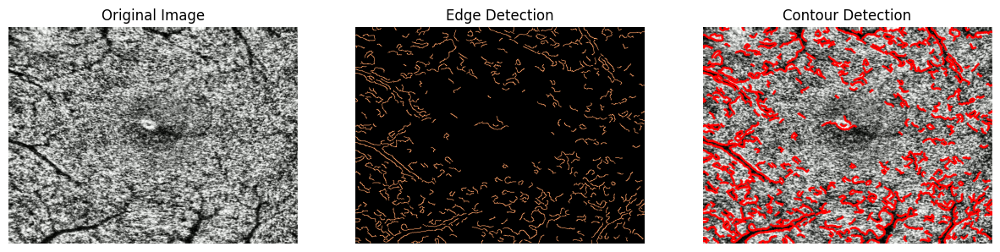

In [52]:
plot_edges_and_contours(cv2.imread(image_links['good'][8]))

### Transfer/Deep Learning

### GANs

In [350]:
train_loader = DataLoader(train_dataset_good, batch_size=batch_size, shuffle=True)

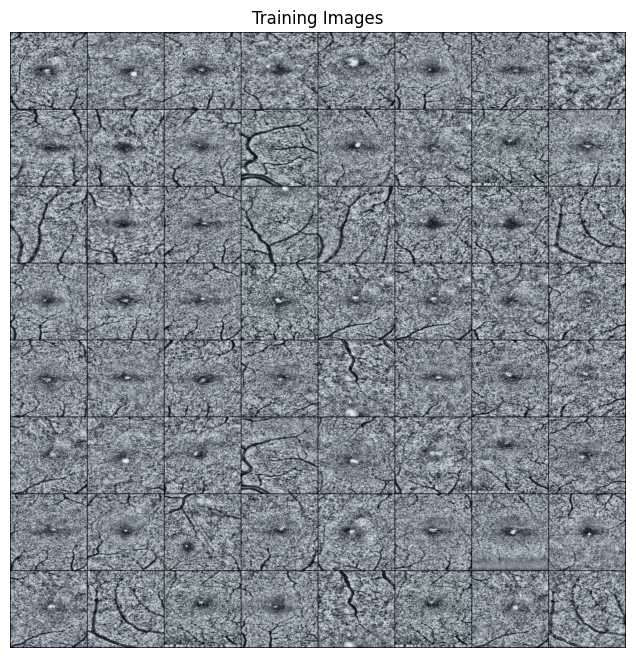

In [351]:
real_batch = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [352]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [353]:
# Root directory for dataset
dataroot = "data/celeba"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 224

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [354]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),
            # state size. (ngf*16) x 4 x 4
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 16 x 16
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 32 x 32
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 64 x 64
            nn.ConvTranspose2d(ngf, ngf // 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf // 2),
            nn.ReLU(True),
            # state size. (ngf/2) x 128 x 128
            nn.ConvTranspose2d(ngf // 2, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 256 x 256
        )

    def forward(self, input):
        return self.main(input)

In [355]:
# Create the generator
netG = Generator(1).to(device)

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchN

In [356]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        ndf = 64  # Size of feature maps in discriminator, adjust if necessary
        nc = 3    # Number of channels in the input images (e.g., for RGB images)

        self.main = nn.Sequential(
            # input is (nc) x 224 x 224
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 112 x 112
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 56 x 56
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 28 x 28
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 14 x 14
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*16) x 7 x 7
            nn.Conv2d(ndf * 16, ndf * 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 32),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*32) x 3 x 3
            nn.Conv2d(ndf * 32, 1, 3, 1, 0, bias=False),
            nn.Sigmoid()
            # state size. 1 x 1 x 1
        )

    def forward(self, input):
        return self.main(input)

In [357]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(1024, eps=1e-05

In [358]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(224 * 224, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [364]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(train_loader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        print('b_size:', b_size)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        print(output.size(0))
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        label = torch.full((output.size(0),), fake_label, dtype=torch.float, device=device)
        print(output.shape)
        print(label.shape)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(train_loader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
b_size: 64
64
torch.Size([256])
torch.Size([256])
[0/5][0/2]	Loss_D: 2.4575	Loss_G: 8.8404	D(x): 0.3528	D(G(z)): 0.4644 / 0.0833


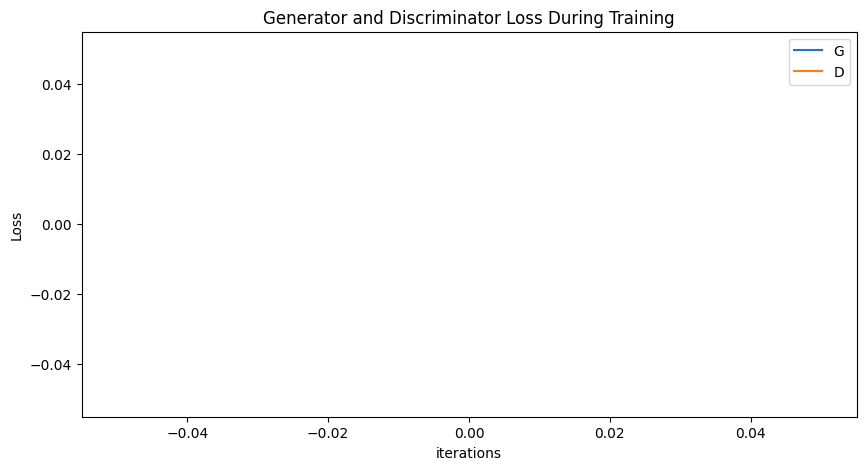

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

NameError: name 'animation' is not defined

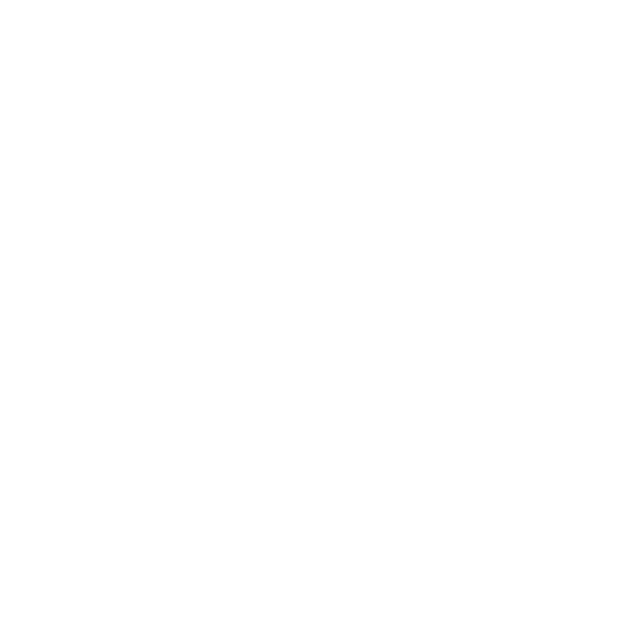

In [306]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())